Geoinformatik 2 – GIS Analyse
# **Übung 7** · Punktmusteranalyse: Deskriptive räumliche Analyse und Dichtebasierte Methoden
Prof. Dr. Yu Feng

## Lernziele
- Punktmuster visualisieren
- Dichtanalyse 

## Hinweis zur Umgebung

**Empfehlung: Google Colab verwenden!**

Google Colab ermöglicht es Ihnen, diese Übung ohne lokale Installation durchzuführen. Damit sparen Sie sich viele Dependency-Probleme:
- Alle notwendigen Bibliotheken sind vorinstalliert
- Keine lokale Umgebungskonfiguration erforderlich
- Kostenlos mit Google-Account zugänglich

Link: [Google Colab](https://colab.research.google.com)

**Falls Sie lokal arbeiten möchten:**

Wenn Sie Dependency-Probleme feststellen, installieren Sie die erforderlichen Python-Pakete:

In [ ]:
#!pip install geopandas
#!pip install pysal
#!pip install pygeos

!pip install contextily
!pip install mapclassify
!pip install folium

## Räumliche Punktmuster in Tokyo-Fotografien

Analyse von georeferenzierten Flickr-Fotos zur Untersuchung räumlicher Verteilungen in Städten.

### Bibliotheken laden

In [ ]:
import numpy
import pandas
import geopandas as gpd
import seaborn
import contextily
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon

### Daten laden
Datensatz enthält 10.000 Fotografien mit User-ID, Koordinaten (lat/lon + Pseudo-Mercator), Zeitstempel und URL.

In [77]:
# Für Google Colab: Pfad anpassen!
db = pandas.read_csv("data/tokyo_clean.csv")
db.head()

,user_id,longitude,latitude,date_taken,photo/video_page_url,x,y
0,10727420@N00,139.700499,35.674000,2010-04-09 17:26:25.0,http://www.flickr.com/photos/10727420@N00/4545...,1.555139e+07,4.255856e+06
1,8819274@N04,139.766521,35.709095,2007-02-10 16:08:40.0,http://www.flickr.com/photos/8819274@N04/26503...,1.555874e+07,4.260667e+06
2,62068690@N00,139.765632,35.694482,2008-12-21 15:45:31.0,http://www.flickr.com/photos/62068690@N00/3125...,1.555864e+07,4.258664e+06
3,49503094041@N01,139.784391,35.548589,2011-11-11 05:48:54.0,http://www.flickr.com/photos/49503094041@N01/6...,1.556073e+07,4.238684e+06
4,40443199@N00,139.768753,35.671521,2006-04-06 16:42:49.0,http://www.flickr.com/photos/40443199@N00/2482...,1.555899e+07,4.255517e+06


**Hinweis:** Räumliche Information liegt als separate Spalten (longitude, latitude) vor, nicht als Geometry-Objekte.

## Visualisierung von Punktmustern

### Punkte als Scatter-Plot

Einfacher Scatter-Plot zur ersten Übersicht:

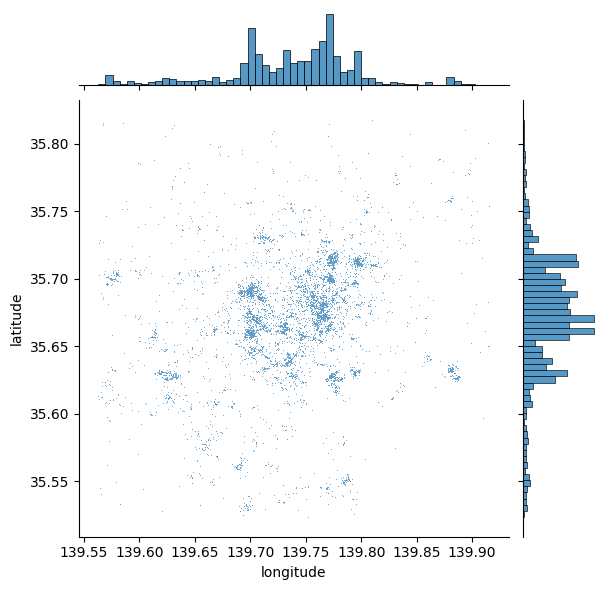

In [43]:
# Generate scatter plot
seaborn.jointplot(x="longitude", y="latitude", data=db, s=0.5);

**Problem:** Keine geografische Kontextinformation und Überlagerung bei hoher Dichte.

**Lösung:** Basemap hinzufügen:

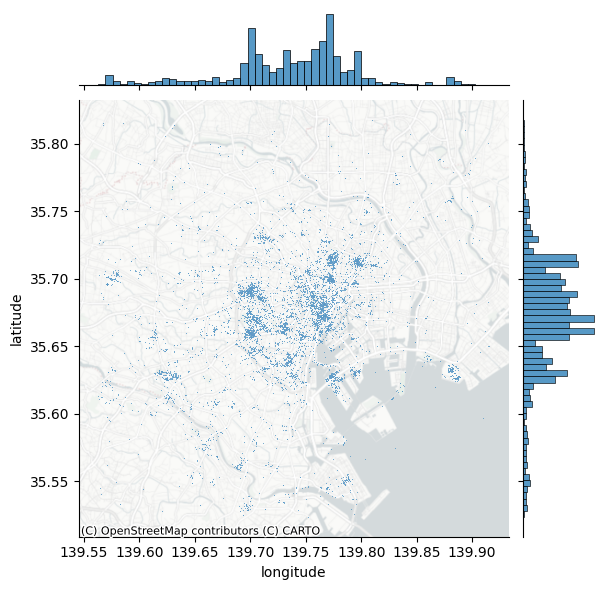

In [44]:
# Generate scatter plot
joint_axes = seaborn.jointplot(
    x="longitude", y="latitude", data=db, s=0.5
)
contextily.add_basemap(
    joint_axes.ax_joint,
    crs="EPSG:4326",
    source=contextily.providers.CartoDB.PositronNoLabels,
);

Die Basemap macht das Muster klarer erkennbar.

## Räumliche Aggregation: Punkt-im-Polygon-Analyse

### GeoJSON-Grenzdaten laden

Lesen der Grenzdaten für die Tokio-Metropolregion:

In [78]:
# GeoJSON-Grenzdaten laden
# Für Google Colab: Pfad anpassen!
boundaries = gpd.read_file("data/Greater_Tokyo_Area.geojson")
print(f"Grenzen geladen: {len(boundaries)} Regionen")
boundaries.explore()

Grenzen geladen: 382 Regionen


### Punkt-im-Polygon: Punkte den Regionen zuordnen

Zuordnung der Fotografiepunkte zu den Grenzen und Zählung:

In [ ]:
# Create GeoDataFrame for points
gdf_points = gpd.GeoDataFrame(
    db,
    geometry=gpd.points_from_xy(db.longitude, db.latitude),
    crs="EPSG:4326"
)

# Ensure CRS matches
if boundaries.crs != gdf_points.crs:
    boundaries = boundaries.to_crs(gdf_points.crs)

# Spatial join: assign points to polygons
########### Your code here ##############



#########################################

# Count points per polygon index
########### Your code here ##############



#########################################

# Merge counts back into boundaries, include polygons with zero points
########### Your code here ##############



#########################################

# Replace NaN with 0
########### Your code here ##############



#########################################

print(boundaries_with_counts[["index_right", "point_count"]].head())

   index_right  point_count
0            0            0
1            1            0
2            2            0
3            3            0
4            4            0


### Visualisierung der Intensity-Choropleth-Karte

Darstellung der Punktdichte nach Regionen:

In [81]:
cells_with_points = boundaries_with_counts[boundaries_with_counts["point_count"] > 0]
cells_with_points.explore(
    column="point_count",
    cmap="viridis",
    scheme="naturalbreaks",
    k=5,
    legend=True
)

### Intensity berechnen: Punktdichte pro Region

Berechnung der Intensität (Punkte pro Fläche):

In [ ]:
# Statistiken zusammenführen
region_stats = boundaries.copy()
region_stats = region_stats.reset_index(drop=True)
region_stats["point_count"] = region_stats.index.map(
    region_counts.set_index("index_right")["point_count"]
).fillna(0).astype(int)

# Intensity: Punkte pro m² 
########### Your code here ##############



#########################################

# Übersicht
print("\nRegionale Statistiken:")
print(region_stats[["point_count", "SUM_AREA", "intensity"]].describe())


Regionale Statistiken:
       point_count     SUM_AREA   intensity
count   382.000000   382.000000  382.000000
mean     25.774869    96.522783    1.671436
std     141.690123   129.357509   10.475273
min       0.000000     4.056794    0.000000
25%       0.000000    22.849361    0.000000
50%       0.000000    50.270465    0.000000
75%       0.000000   122.812453    0.000000
max    1470.000000  1448.962369  115.279485


In [ ]:
cells_with_dens = region_stats[region_stats["intensity"] > 0].copy()

cells_with_dens.explore(
    column="intensity",
    cmap="viridis",
    scheme="naturalbreaks",   
    k=5,
    legend=True
)

In [82]:
# Top 10 Regionen nach Intensität
top_regions = region_stats.nlargest(10, "intensity")[
    ["NAME_1","point_count", "SUM_AREA", "intensity"]
].copy()
print("\nTop 10 Regionen nach Fotografieintensität:")
print(top_regions.round(2))


Top 10 Regionen nach Fotografieintensität:
          NAME_1  point_count  SUM_AREA  intensity
235   Chiyoda-ku         1310     11.36     115.28
240     Taito-ku          941     10.09      93.30
236      Chuo-ku          765      8.97      85.32
247   Shibuya-ku         1093     15.12      72.30
237    Minato-ku         1470     20.71      70.99
238  Shinjuku-ku          740     18.27      40.51
239    Bunkyo-ku          258     11.37      22.69
241    Sumida-ku          204     13.74      14.85
244    Meguro-ku          198     14.84      13.34
250   Toshima-ku          158     12.97      12.18


### Dichte durch Hexbinning

Bei starker Überlagerung: Hexagonales Raster zur Aggregation nutzen.
Hexagone bieten weniger Verzerrung und gleichmäßigere Nachbarschaft als Quadrate.

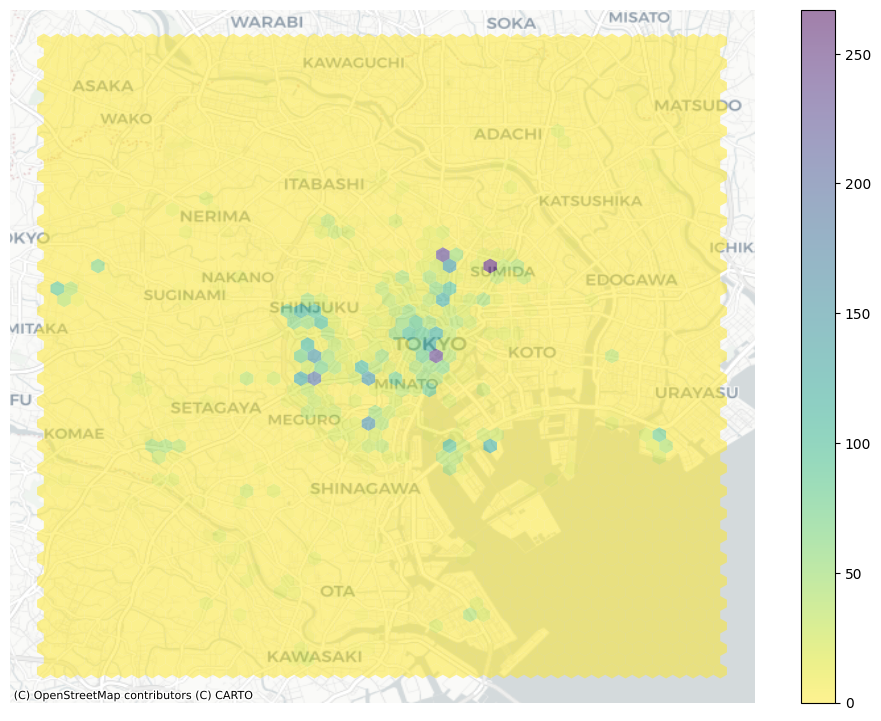

In [51]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(12, 9))
# Generate and add hexbin with 50 hexagons in each
# dimension, no borderlines, half transparency,
# and the reverse viridis colormap
hb = ax.hexbin(
    db["x"],
    db["y"],
    gridsize=50,
    linewidths=0,
    alpha=0.5,
    cmap="viridis_r",
)
# Add basemap
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
# Add colorbar
plt.colorbar(hb)
# Remove axes
ax.set_axis_off()

In [52]:
# ---- Build GeoDataFrame from hexbin result ----

# Centers of each hexagon
offsets = hb.get_offsets()          # shape (N, 2)

# Template hexagon (vertices around (0, 0))
base_hex = hb.get_paths()[0].vertices  # shape (7, 2), closed ring

# Build shapely Polygons for each hex
polygons = [Polygon(base_hex + xy) for xy in offsets]

# Values per hex (counts or aggregated values)
values = hb.get_array()            # length N

# Create GeoDataFrame; assume x/y are EPSG:3857
hex_gdf = gpd.GeoDataFrame(
    {"value": values},
    geometry=polygons,
    crs="EPSG:3857"
)

# Reproject to WGS84 for web mapping and save as GeoJSON
hex_gdf_4326 = hex_gdf.to_crs(epsg=4326)
#hex_gdf_4326.to_file("hexbin.geojson", driver="GeoJSON")
hex_gdf_4326.explore(
    column="value",
    cmap="viridis_r",
    legend=True
)

Hexbinning zeigt deutlich lokalisierte Hotspots.

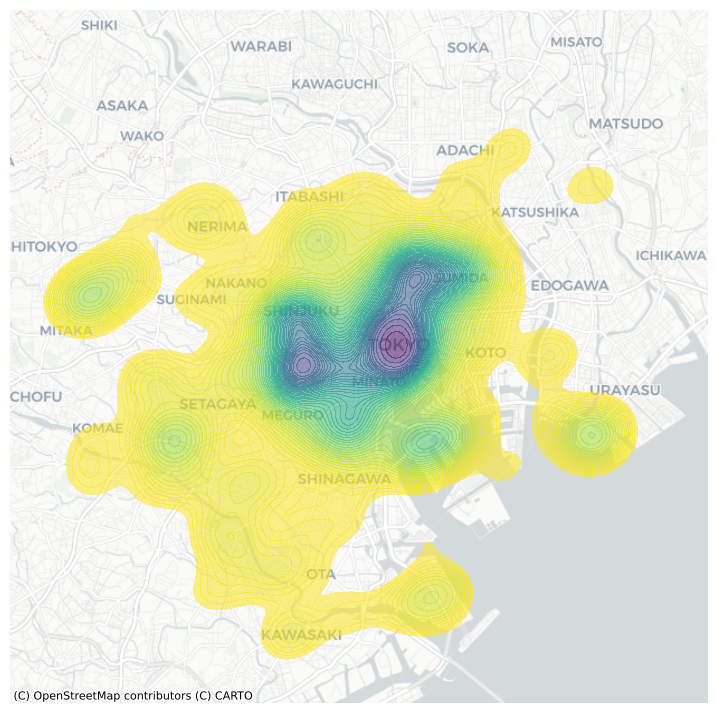

In [53]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Generate and add KDE with a shading of 50 gradients
# coloured contours, 75% of transparency,
# and the reverse viridis colormap
seaborn.kdeplot(
    x="x",
    y="y",
    data=db,
    n_levels=50,
    fill=True,
    alpha=0.55,
    cmap="viridis_r",
)
# Add basemap
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
# Remove axes
ax.set_axis_off()

KDE erzeugt glattere Übergänge zwischen Dichtegebieten.

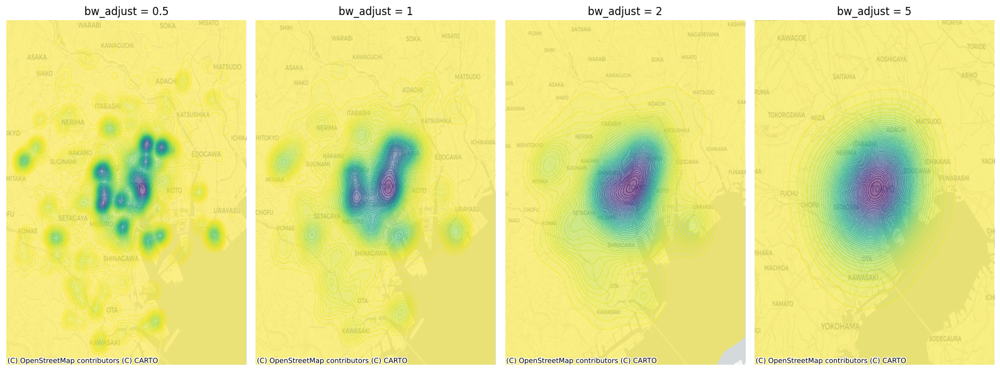

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import contextily


########### Your code here ##############

# bandwidths = 

#########################################

fig, axes = plt.subplots(1, len(bandwidths), figsize=(4*len(bandwidths), 6))

# predefine global contour levels (0 to 1 normalized)
levels = np.linspace(0, 1, 50)

for ax, bw in zip(axes, bandwidths):
    seaborn.kdeplot(
        x="x",
        y="y",
        data=db,
        bw_adjust=bw,
        fill=True,
        alpha=0.55,
        cmap="viridis_r",
        levels=levels,     # <---- IMPORTANT
        thresh=0,
        ax=ax
    )

    contextily.add_basemap(ax, source=contextily.providers.CartoDB.Positron)
    ax.set_title(f"bw_adjust = {bw}")
    ax.set_axis_off()

plt.tight_layout()


## Zentrographie

Analyse von Zentralität: Lage und Streuung des Punktmusters durch kompakte Maße beschreiben.

### Zentrale Tendenz

**Mean Center:** Durchschnitt der Koordinaten  
**Median Center:** Mittlerer Punkt (je 50% über/unter bzw. links/rechts)

In [55]:
from pointpats import centrography

In [56]:
mean_center = centrography.mean_center(db[["x", "y"]])
med_center = centrography.euclidean_median(db[["x", "y"]])

Visualisierung:

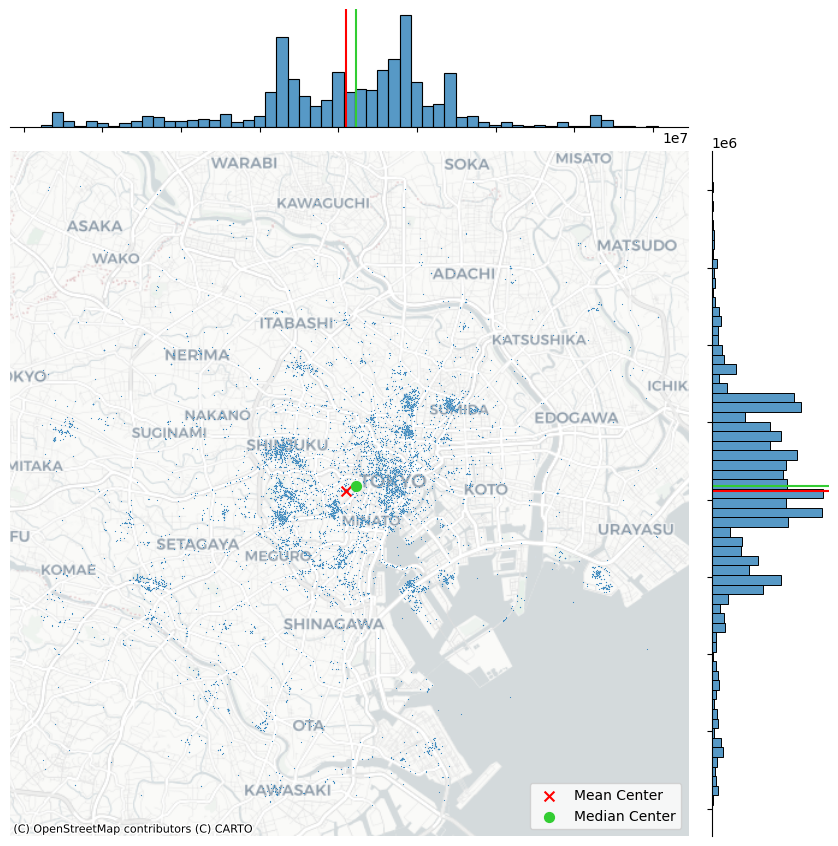

In [57]:
# Generate scatterplot
joint_axes = seaborn.jointplot(
    x="x", y="y", data=db, s=0.75, height=9
)
# Add mean point and marginal lines
joint_axes.ax_joint.scatter(
    *mean_center, color="red", marker="x", s=50, label="Mean Center"
)
joint_axes.ax_marg_x.axvline(mean_center[0], color="red")
joint_axes.ax_marg_y.axhline(mean_center[1], color="red")
# Add median point and marginal lines
joint_axes.ax_joint.scatter(
    *med_center,
    color="limegreen",
    marker="o",
    s=50,
    label="Median Center"
)
joint_axes.ax_marg_x.axvline(med_center[0], color="limegreen")
joint_axes.ax_marg_y.axhline(med_center[1], color="limegreen")
# Legend
joint_axes.ax_joint.legend()
# Add basemap
contextily.add_basemap(
    joint_axes.ax_joint, source=contextily.providers.CartoDB.Positron
)
# Clean axes
joint_axes.ax_joint.set_axis_off()
# Display
plt.show()

Die Diskrepanz entsteht durch periphere Cluster (West/Süd-Tokyo), die den Mittelwert verzerren.

**Standard Distance:** Durchschnittliche Entfernung vom Zentrum

In [58]:
centrography.std_distance(db[["x", "y"]])

8778.218564382098

Durchschnittliche Distanz: ~8800 Meter vom Mean Center.

**Standard-Ellipse:** Visualisiert Zentrum, Streuung und Orientierung des Musters.

In [59]:
major, minor, rotation = centrography.ellipse(db[["x", "y"]])

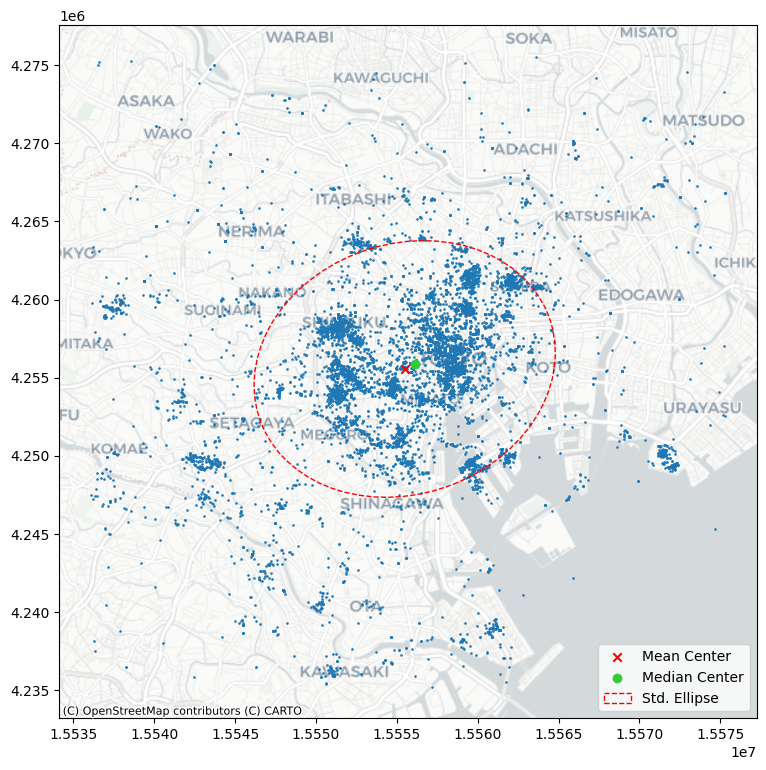

In [60]:
from matplotlib.patches import Ellipse

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot photograph points
ax.scatter(db["x"], db["y"], s=0.75)
ax.scatter(*mean_center, color="red", marker="x", label="Mean Center")
ax.scatter(
    *med_center, color="limegreen", marker="o", label="Median Center"
)

# Construct the standard ellipse using matplotlib
ellipse = Ellipse(
    xy=mean_center,  # center the ellipse on our mean center
    width=major * 2,  # centrography.ellipse only gives half the axis
    height=minor * 2,
    angle=numpy.rad2deg(
        rotation
    ),  # Angles for this are in degrees, not radians
    facecolor="none",
    edgecolor="red",
    linestyle="--",
    label="Std. Ellipse",
)
ax.add_patch(ellipse)

ax.legend()
# Display
# Add basemap
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
plt.show()

### Ausdehnung

Verschiedene Formen zur Beschreibung der räumlichen Ausdehnung.
Beispiel: Nutzer mit ID `95795770` (aktivster Nutzer).

In [61]:
user = db.query('user_id == "95795770@N00"')
coordinates = user[["x", "y"]].values

**Convex Hull:** Kleinste konvexe Form, die alle Punkte umschließt (keine Einbuchtungen).

In [62]:
convex_hull_vertices = centrography.hull(coordinates)

**Alpha Shape:** Engere Form als Convex Hull. Metapher: Eine kleine Kugel rollt um die Punkte und folgt Einbuchtungen. 
Bei zu kleinem Alpha entstehen mehrere Hüllen. `alpha_shape_auto` findet die kleinste zusammenhängende Form.

In [63]:
import libpysal

alpha_shape, alpha, circs = libpysal.cg.alpha_shape_auto(
    coordinates, return_circles=True
)

/var/folders/56/_0_zr2cn2wbbnf3z1v7_rs000000gn/T/ipykernel_18371/2900823114.py:36: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend();


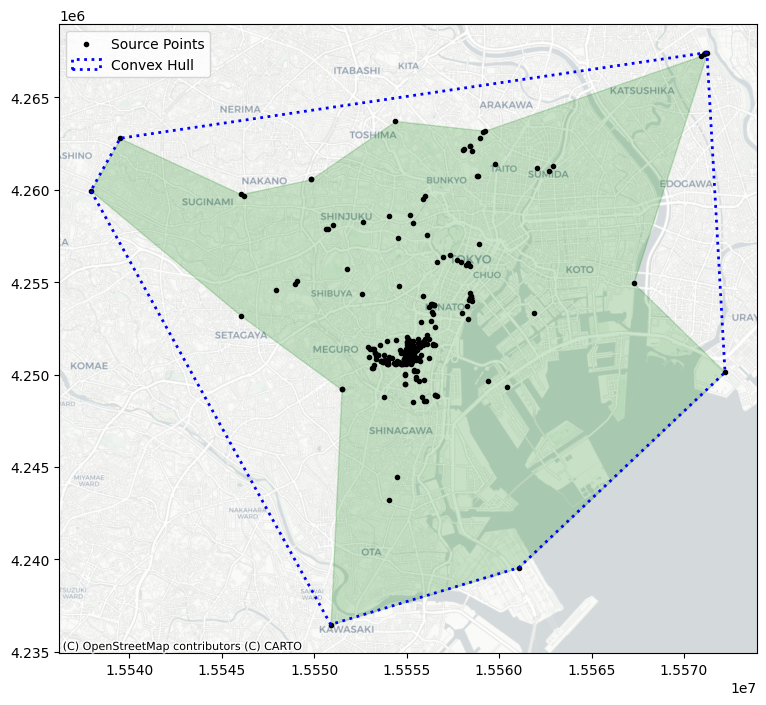

In [64]:
f, ax = plt.subplots(1, 1, figsize=(9, 9))

# Plot a green alpha shape
gpd.GeoSeries(
    [alpha_shape]
).plot(
    ax=ax,
    edgecolor="green",
    facecolor="green",
    alpha=0.2,
    label="Tightest single alpha shape",
)

# Include the points for our prolific user in black
ax.scatter(
    *coordinates.T, color="k", marker=".", label="Source Points"
)

# add a blue convex hull
ax.add_patch(
    plt.Polygon(
        convex_hull_vertices,
        closed=True,
        edgecolor="blue",
        facecolor="none",
        linestyle=":",
        linewidth=2,
        label="Convex Hull",
    )
)

# Add basemap
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
plt.legend();

## Homogenität und Clustering

Analyse der räumlichen Homogenität: Sind Punkte geclustert oder gleichmäßig verteilt?

**Zwei Ansätze:**
1. **Quadrat-Statistiken:** Zählen in regelmäßigen Zellen
2. **Ripley-Funktionen:** Distanzmessungen zwischen Punkten (nächste Woche)

In [ ]:
from pointpats import (
    QStatistic,
    random,
)

### CSR generieren

**Poisson-Prozess:** Vollständig zufälliger räumlicher Prozess (CSR) zum Vergleich.

In [66]:
random_pattern = random.poisson(coordinates, size=len(coordinates))

Visualisierung:

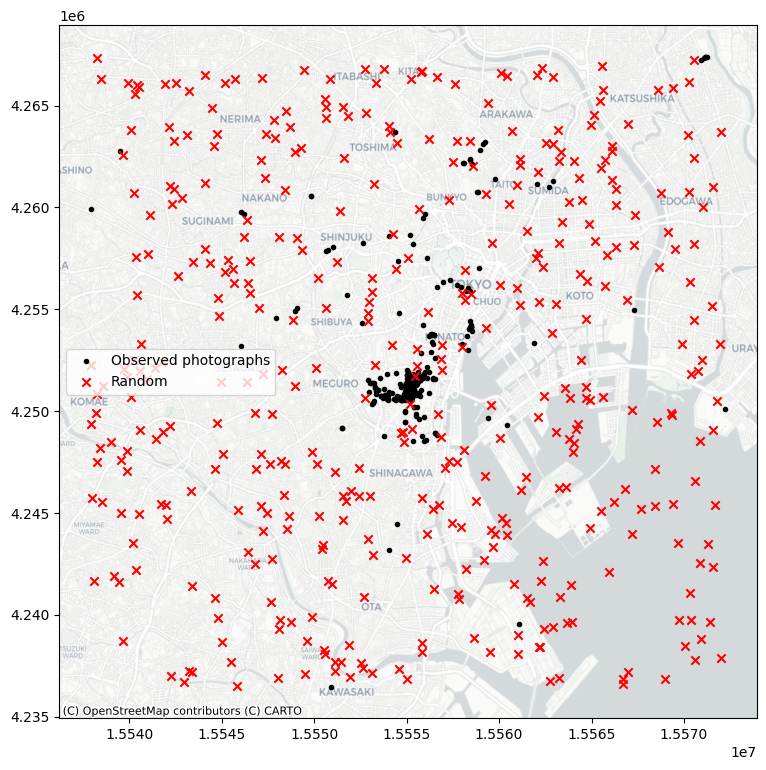

In [67]:
f, ax = plt.subplots(1, figsize=(9, 9))
plt.scatter(
    *coordinates.T,
    color="k",
    marker=".",
    label="Observed photographs"
)
plt.scatter(*random_pattern.T, color="r", marker="x", label="Random")
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
ax.legend(ncol=1, loc="center left")
plt.show()

Standard: Simulation in Bounding Box. Für eingeschränkte Bereiche (z.B. Alpha Shape):

In [83]:
random_pattern_ashape = random.poisson(
    alpha_shape, size=len(coordinates)
)

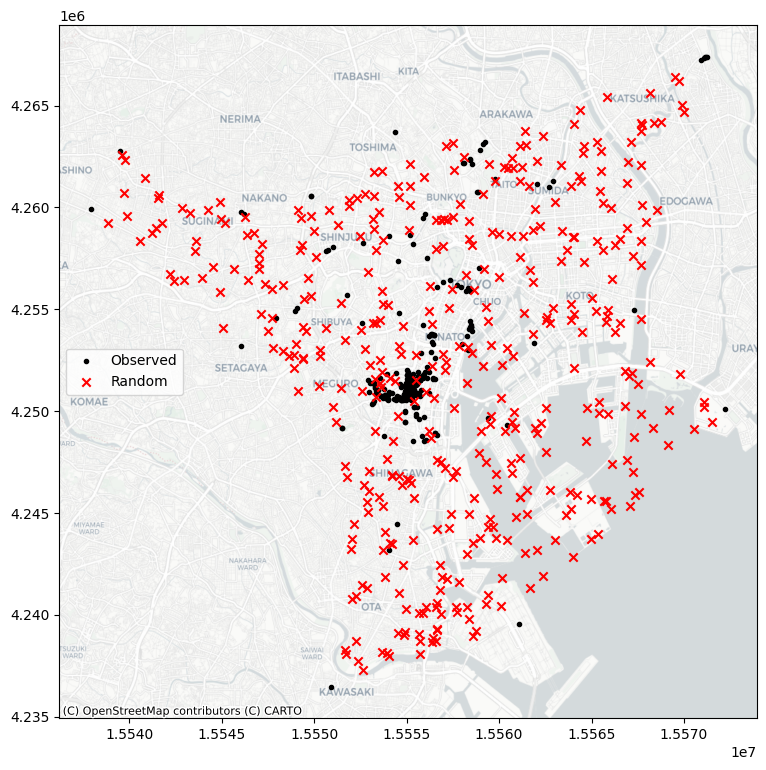

In [84]:
f, ax = plt.subplots(1, figsize=(9, 9))
plt.scatter(*coordinates.T, color="k", marker=".", label="Observed")
plt.scatter(
    *random_pattern_ashape.T, color="r", marker="x", label="Random"
)
contextily.add_basemap(
    ax, source=contextily.providers.CartoDB.Positron
)
ax.legend(ncol=1, loc="center left")
plt.show()

### Quadrat-Statistiken

Testet Gleichmäßigkeit der Verteilung durch Zählen in Zellen (χ²-Test).
Visualisierung mit `QStatistic.plot()`:

<Axes: title={'center': 'Quadrat Count'}>

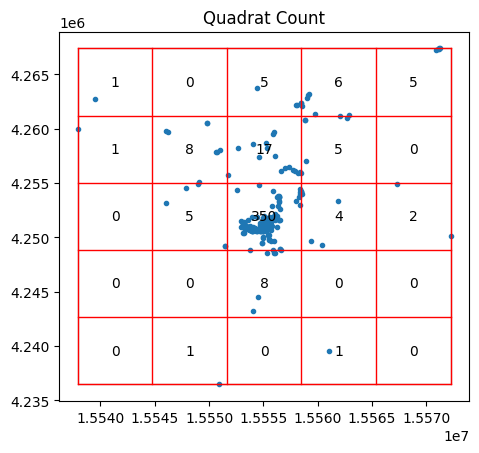

In [95]:
qstat = QStatistic(coordinates,nx=5, ny=5)
qstat.plot()

Zentrale Zelle: >350 Beobachtungen, Randzellen deutlich weniger → χ²-Test signifikant (sehr kleiner p-Wert):

In [96]:
qstat.chi2_pvalue

0.0

Im Gegensatz: Zufallsmuster hat gleichmäßige Verteilung:

<Axes: title={'center': 'Quadrat Count'}>

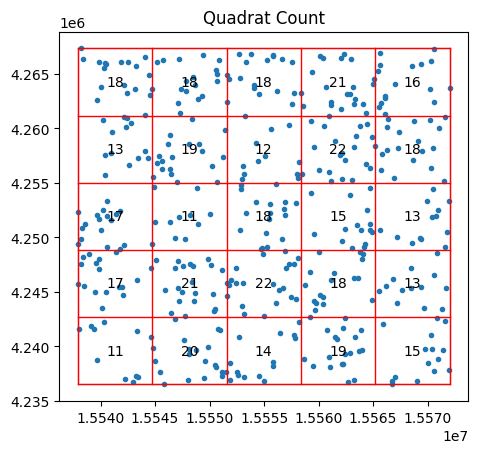

In [ ]:
########### Your code here ##############

# qstat_null = 

#########################################
qstat_null.plot()

P-Wert ist groß (nicht signifikant):

In [99]:
qstat_null.chi2_pvalue

0.8914909530631201

**Vorsicht:** Unregelmäßige Untersuchungsgebiete können zu Fehlinterpretationen führen.
Zufallsmuster innerhalb Alpha Shape:

<Axes: title={'center': 'Quadrat Count'}>

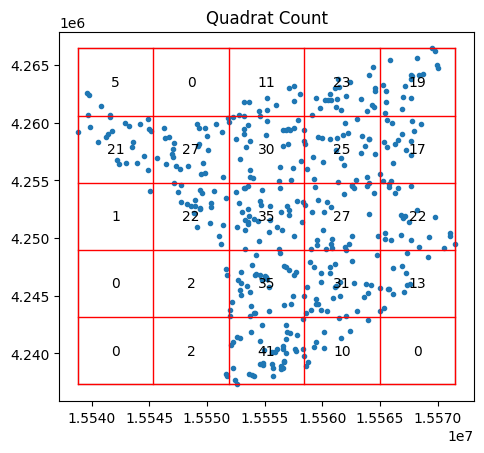

In [ ]:
########### Your code here ##############

# qstat_null_ashape = 

#########################################
qstat_null_ashape.plot()

Test findet signifikantes Clustering, obwohl Prozess zufällig ist:

In [101]:
qstat_null_ashape.chi2_pvalue

5.000226949745208e-38

**Fazit:** Quadrat-Statistik testet Gleichmäßigkeit über reguläres Raster. Bei unregelmäßigen Gebieten mit Vorsicht verwenden.

## Daten & Referenz
- Point Pattern Analysis — Geographic Data Science with Python: https://geographicdata.science/book/notebooks/08_point_pattern_analysis.html (CC BY-NC-ND 4.0)
- Boundaries of Japan: https://www.arcgis.com/home/item.html?id=d287ffee9142467c81f317ba7060e31f